# Segmentation of underwater objects (animals and other debris)
This notebook provides a compact EDA of the SeaClear dataset and generates COCO-format **train/val/test** splits that are used later for Mask R-CNN training.


In [5]:
import json
import random
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import cv2
from tqdm import tqdm
from pycocotools.coco import COCO

from sklearn.model_selection import train_test_split

DATA_DIR = Path("data")
COCO_JSON = DATA_DIR / "dataset.json"

SEED = 42
random.seed(SEED)
np.random.seed(SEED)

## Dataset structure (locations / cameras)
The raw images are organized by location and camera. Below is a quick scan of the folder layout and a few example file paths.


In [45]:
rows = []
img_exts = (".jpg")

for loc_dir in sorted(p for p in DATA_DIR.iterdir() if p.is_dir()):
    loc = loc_dir.name
    for cam_dir in sorted(p for p in loc_dir.iterdir() if p.is_dir()):
        cam = cam_dir.name
        for p in cam_dir.rglob("*"):
            if p.is_file() and p.suffix.lower() in img_exts:
                rel = p.relative_to(DATA_DIR)
                rows.append({
                    "path": p,
                    "file_name": p.name,
                    "location": loc,
                    "camera": cam,
                    "domain": f"{loc}/{cam}",
                })

fs_df = pd.DataFrame(rows)

print("Locations:", sorted(fs_df["location"].unique()))

display(fs_df.sort_values("path")
        .groupby("location", as_index=False)
        .head(1)[["path", "file_name", "location", "camera", "domain"]]
        .reset_index(drop=True))

Locations: ['Bistrina', 'Jakljan', 'Lokrum', 'Marseille', 'Slano']


,path,file_name,location,camera,domain
0,data\Bistrina\Bluerobotics HD\1.jpg,1.jpg,Bistrina,Bluerobotics HD,Bistrina/Bluerobotics HD
1,data\Jakljan\Bluerobotics HD\.ipynb_checkpoint...,4272-checkpoint.jpg,Jakljan,Bluerobotics HD,Jakljan/Bluerobotics HD
2,data\Lokrum\Bluerobotics HD\233.jpg,233.jpg,Lokrum,Bluerobotics HD,Lokrum/Bluerobotics HD
3,data\Marseille\SIP-E323CV\Cam1_16_23_22_10_11_...,Cam1_16_23_22_10_11_2020.mp4_00500.jpg,Marseille,SIP-E323CV,Marseille/SIP-E323CV
4,data\Slano\Bluerobotics HD\.ipynb_checkpoints\...,65-checkpoint.jpg,Slano,Bluerobotics HD,Slano/Bluerobotics HD


## Dataset summary
Load COCO annotations and build a table that links each COCO image to its local file path and domain metadata (location, camera).


In [30]:
coco = COCO(str(COCO_JSON))

img_ids = coco.getImgIds()
ann_ids = coco.getAnnIds()
cat_ids = coco.getCatIds()

ann_df = pd.DataFrame(coco.loadAnns(ann_ids)).rename(columns={"id": "ann_id"})

cats = coco.loadCats(cat_ids)
id2name = {c["id"]: c["name"] for c in cats}

print("Images:", len(img_ids), "| Annotations:", len(ann_ids), "| Categories:", len(cat_ids))

name_to_path = fs_df.groupby("file_name")["path"].first().to_dict()

def resolve_path(file_name: str) -> Path:
    p = DATA_DIR / file_name
    if p.exists():
        return p

    key = str(Path(file_name))
    if key in rel_to_path:
        return rel_to_path[key]

    return name_to_path.get(Path(file_name).name, p)

img_df = (
    pd.DataFrame(coco.loadImgs(img_ids))[["id", "file_name"]]
      .rename(columns={"id": "image_id"})
)

img_df["path"] = img_df["file_name"].apply(resolve_path)
img_df["location"] = img_df["path"].apply(lambda p: p.relative_to(DATA_DIR).parts[0])
img_df["camera"]   = img_df["path"].apply(lambda p: p.relative_to(DATA_DIR).parts[1])
img_df["domain"]   = img_df["location"] + "/" + img_df["camera"]

# Human-readable class names for EDA
ann_df["subclass"] = ann_df["category_id"].map(id2name)

img_df.head(len(img_ids))

loading annotations into memory...
Done (t=0.35s)
creating index...
index created!
Images: 8610 | Annotations: 31555 | Categories: 40


,image_id,file_name,path,location,camera,domain
0,0,1.jpg,data\Bistrina\Bluerobotics HD\1.jpg,Bistrina,Bluerobotics HD,Bistrina/Bluerobotics HD
1,1,Bistrina/Bluerobotics HD/1.jpg,data\Bistrina\Bluerobotics HD\1.jpg,Bistrina,Bluerobotics HD,Bistrina/Bluerobotics HD
2,2,Bistrina/Bluerobotics HD/2.jpg,data\Bistrina\Bluerobotics HD\2.jpg,Bistrina,Bluerobotics HD,Bistrina/Bluerobotics HD
3,3,Bistrina/Bluerobotics HD/3.jpg,data\Bistrina\Bluerobotics HD\3.jpg,Bistrina,Bluerobotics HD,Bistrina/Bluerobotics HD
4,4,Bistrina/Bluerobotics HD/4.jpg,data\Bistrina\Bluerobotics HD\4.jpg,Bistrina,Bluerobotics HD,Bistrina/Bluerobotics HD
...,...,...,...,...,...,...
8605,8605,Cam1_16_33_38_10_11_2020.mp4_01301.jpg,data\Marseille\SIP-E323CV\Cam1_16_33_38_10_11_...,Marseille,SIP-E323CV,Marseille/SIP-E323CV
8606,8606,Cam1_16_33_38_10_11_2020.mp4_01302.jpg,data\Marseille\SIP-E323CV\Cam1_16_33_38_10_11_...,Marseille,SIP-E323CV,Marseille/SIP-E323CV
8607,8607,Cam1_16_33_38_10_11_2020.mp4_01303.jpg,data\Marseille\SIP-E323CV\Cam1_16_33_38_10_11_...,Marseille,SIP-E323CV,Marseille/SIP-E323CV
8608,8608,Cam1_16_33_38_10_11_2020.mp4_01304.jpg,data\Marseille\SIP-E323CV\Cam1_16_33_38_10_11_...,Marseille,SIP-E323CV,Marseille/SIP-E323CV


## Images by location, camera, and domain

In [31]:
loc_counts = img_df["location"].value_counts().reset_index()
loc_counts.columns = ["location", "n_images"]

print("Images by location:")
display(loc_counts)

Images by location:


,location,n_images
0,Bistrina,3663
1,Marseille,3441
2,Lokrum,960
3,Jakljan,306
4,Slano,240


In [32]:
cam_counts = img_df["camera"].value_counts().reset_index()
cam_counts.columns = ["camera", "n_images"]

print("Images by camera:")
display(cam_counts)

Images by camera:


,camera,n_images
0,SIP-E323CV,3961
1,Bluerobotics HD,2367
2,Paralenz Vaquita Gen 2,2146
3,Paralenz Vaquita,136


In [33]:
domain_counts = img_df["domain"].value_counts().reset_index()
domain_counts.columns = ["domain", "n_images"]

print("Images by domain (location/camera):")
display(domain_counts)

Images by domain (location/camera):


,domain,n_images
0,Marseille/SIP-E323CV,3441
1,Bistrina/Paralenz Vaquita Gen 2,2069
2,Bistrina/Bluerobotics HD,1401
3,Lokrum/Bluerobotics HD,556
4,Lokrum/SIP-E323CV,327
5,Jakljan/Bluerobotics HD,241
6,Bistrina/SIP-E323CV,193
7,Slano/Bluerobotics HD,169
8,Lokrum/Paralenz Vaquita Gen 2,77
9,Slano/Paralenz Vaquita,71


## Class distribution (fine-grained categories)
Count the number of annotated instances per class to highlight class imbalance.


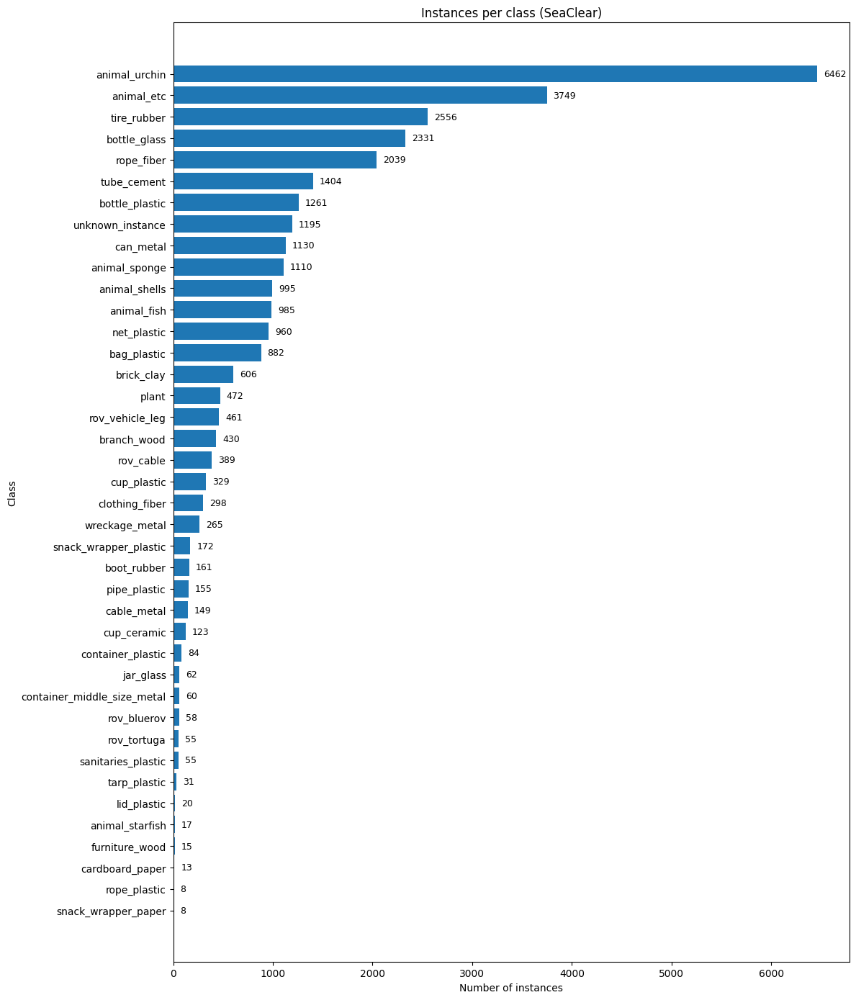

In [46]:
ann_df["class"] = ann_df["category_id"].map(id2name)
class_counts = ann_df["class"].value_counts().sort_values(ascending=True)

plt.figure(figsize=(12, max(6, 0.35 * len(class_counts))))
bars = plt.barh(class_counts.index, class_counts.values)

plt.title("Instances per class (SeaClear)")
plt.xlabel("Number of instances")
plt.ylabel("Class")

max_v = class_counts.max()
for b in bars:
    v = int(b.get_width())
    y = b.get_y() + b.get_height() / 2
    plt.text(v + max_v * 0.01, y, str(v), va="center", fontsize=9)

plt.tight_layout()
plt.show()

### Note
This distribution highlights a clear imbalance in the dataset: some classes are extremely rare (around 8 examples), while a few are heavily represented (2,000+). With such skew, a model tends to overfit to dominant categories and underperform on rare ones. In the next sections, I’ll address this by grouping the 40 fine-grained labels into higher-level superclasses.

## Objects per image

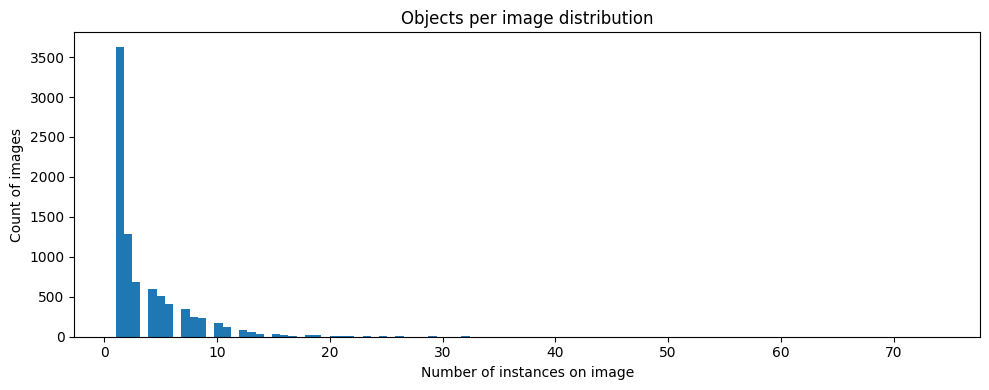

Avg anns/img: 3.665

Anns per image:
  mean: 3.665
  median: 2.0
  p95: 11.0
  max: 74

Images with 0 annotations: 0


In [35]:
ann_per_img = ann_df.groupby("image_id").size()
n_imgs = len(img_df)
n_anns = len(ann_df)

plt.figure(figsize=(10, 4))
plt.hist(ann_per_img.values, bins=100)
plt.title("Objects per image distribution")
plt.xlabel("Number of instances on image")
plt.ylabel("Count of images")
plt.tight_layout()
plt.show()

print("Avg anns/img:", round(n_anns / n_imgs, 3))
print("\nAnns per image:")
print("  mean:", round(ann_per_img.mean(), 3))
print("  median:", float(ann_per_img.median()))
print("  p95:", float(ann_per_img.quantile(0.95)))
print("  max:", int(ann_per_img.max()))

imgs_with_0 = n_imgs - ann_per_img.index.nunique()
print("\nImages with 0 annotations:", imgs_with_0)

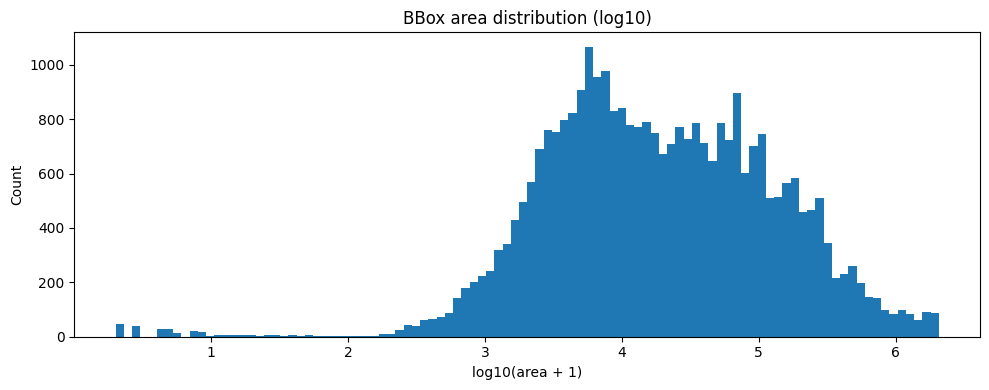

count    3.155500e+04
mean     8.862730e+04
std      2.123717e+05
min      1.000000e+00
1%       2.490800e+02
5%       1.102000e+03
10%      1.976000e+03
50%      1.692900e+04
90%      2.230152e+05
95%      3.958260e+05
99%      1.207639e+06
max      2.071680e+06
Name: bbox_area, dtype: float64

In [36]:
ann_df["bbox_area"] = ann_df["bbox"].apply(lambda b: b[2] * b[3])

plt.figure(figsize=(10, 4))
plt.hist(np.log10(ann_df["bbox_area"] + 1), bins=100)
plt.title("BBox area distribution (log10)")
plt.xlabel("log10(area + 1)")
plt.ylabel("Count")
plt.tight_layout()
plt.show()

ann_df["bbox_area"].describe(percentiles=[0.01, 0.05, 0.1, 0.5, 0.9, 0.95, 0.99])

## Balancing the “bio_nature” dominance
The dataset contains a lot of *bio_nature* instances (animals). To avoid the model learning “animals” too easily and underperforming on debris classes, I reduce the number of animal instances via downsampling, targeting about 30–40% of the training data.

In [37]:
rng = np.random.default_rng(SEED)

targets = {"animal_urchin", "animal_etc", "animal_sponge", "animal_fish", "animal_shells"}
keep_frac = 0.35

mask = ann_df["subclass"].isin(targets)
idx = ann_df.index[mask].to_numpy()

before = len(idx)
keep_n = int(round(before * keep_frac))

keep_idx = rng.choice(idx, size=keep_n, replace=False)
keep_idx = set(keep_idx)

ann_cut = ann_df.loc[~mask | ann_df.index.isin(keep_idx)].copy()

print("Before (target animal subclasses) instances:", before)
print("After  (target animal subclasses) instances:", int(ann_cut["subclass"].isin(targets).sum()))
print("Total instances:", len(ann_df), "->", len(ann_cut))

Before (target animal subclasses) instances: 13301
After  (target animal subclasses) instances: 4655
Total instances: 31555 -> 22909



=== Images per superclass ===
superclass
plastic          3163
bio_nature       2461
rubber           2402
fiber_textile    1643
construction     1517
glass            1365
metal            1147
other             949
rov_equipment     807
wood              224
Name: image_id, dtype: int64


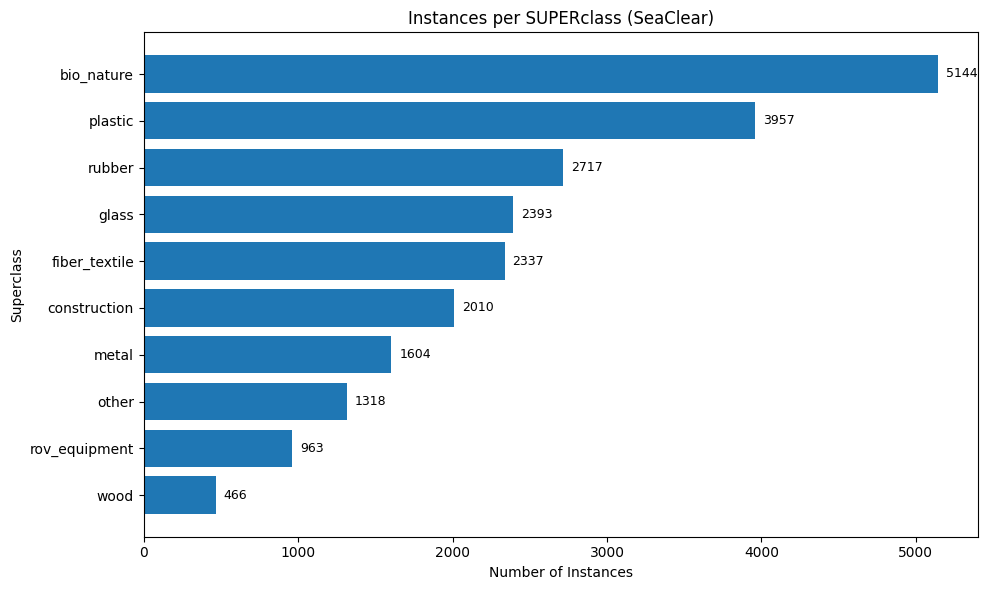

In [47]:
def to_superclass(sub: str) -> str:
    if pd.isna(sub):
        return "other"

    if sub in {"brick_clay", "tube_cement"}:
        return "construction"
    if sub == "plant":
        return "bio_nature"

    if sub.startswith("animal_"):
        return "bio_nature"
    if sub.startswith("rov_"):
        return "rov_equipment"

    if sub.endswith("_plastic"):
        return "plastic"
    if sub.endswith("_metal"):
        return "metal"
    if sub.endswith("_glass"):
        return "glass"
    if sub.endswith("_rubber"):
        return "rubber"
    if sub.endswith("_wood"):   
        return "wood"
    if sub.endswith("_paper"):
        return "wood"
    if sub.endswith("_fiber"):
        return "fiber_textile"

    return "other"

ann_cut["superclass"] = ann_df["subclass"].apply(to_superclass)

super_img_counts = (ann_cut.groupby("superclass")["image_id"].nunique().sort_values(ascending=False))
super_inst_counts = (ann_cut["superclass"].value_counts().sort_values(ascending=True))

print("\n=== Images per superclass ===")
print(super_img_counts)

counts = super_inst_counts 

plt.figure(figsize=(10, max(5, 0.6 * len(counts))))
bars = plt.barh(counts.index, counts.values)

plt.title("Instances per SUPERclass (SeaClear)")
plt.xlabel("Number of Instances")
plt.ylabel("Superclass")

max_v = counts.max()
for b in bars:
    v = int(b.get_width())
    y = b.get_y() + b.get_height() / 2
    plt.text(v + max_v * 0.01, y, str(v), va="center", fontsize=9)

plt.tight_layout()
plt.show()

## Qualitative sanity check
Visualize a small random grid of images with instance masks and bounding boxes to verify annotations and loading logic.


In [39]:
def draw_instances(img_bgr: np.ndarray, anns: list, alpha: float = 0.45) -> np.ndarray:
    out = img_bgr.copy()
    for a in anns:
        cls = id2name.get(a["category_id"], str(a["category_id"]))

        x, y, w, h = a["bbox"]
        x1, y1, x2, y2 = int(x), int(y), int(x + w), int(y + h)
        cv2.rectangle(out, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(out, cls, (x1, max(0, y1 - 6)),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

        m = coco.annToMask(a)
        overlay = out.copy()
        overlay[m.astype(bool)] = (0, 0, 255)
        out = cv2.addWeighted(overlay, alpha, out, 1 - alpha, 0)
    return out

def show_image(image_id: int, figsize=(12, 7)):
    row = img_df.loc[img_df["image_id"] == image_id].iloc[0]
    img_bgr = cv2.imread(str(row["path"]))
    anns_i = coco.loadAnns(coco.getAnnIds(imgIds=[image_id]))

    viz_bgr = draw_instances(img_bgr, anns_i)
    viz_rgb = cv2.cvtColor(viz_bgr, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=figsize)
    plt.title(f"id={image_id} | anns={len(anns_i)} | domain={row['domain']}")
    plt.imshow(viz_rgb)
    plt.axis("off")
    plt.show()

def show_grid(image_ids, cols=3, figsize_scale=5):
    rows = int(np.ceil(len(image_ids) / cols))
    plt.figure(figsize=(cols * figsize_scale, rows * figsize_scale))

    for i, image_id in enumerate(image_ids, start=1):
        row = img_df.loc[img_df["image_id"] == image_id].iloc[0]
        img_bgr = cv2.imread(str(row["path"]))
        anns_i = coco.loadAnns(coco.getAnnIds(imgIds=[image_id]))

        viz_bgr = draw_instances(img_bgr, anns_i)
        viz_rgb = cv2.cvtColor(viz_bgr, cv2.COLOR_BGR2RGB)

        plt.subplot(rows, cols, i)
        plt.imshow(viz_rgb)
        plt.title(f"id={image_id} | {len(anns_i)}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

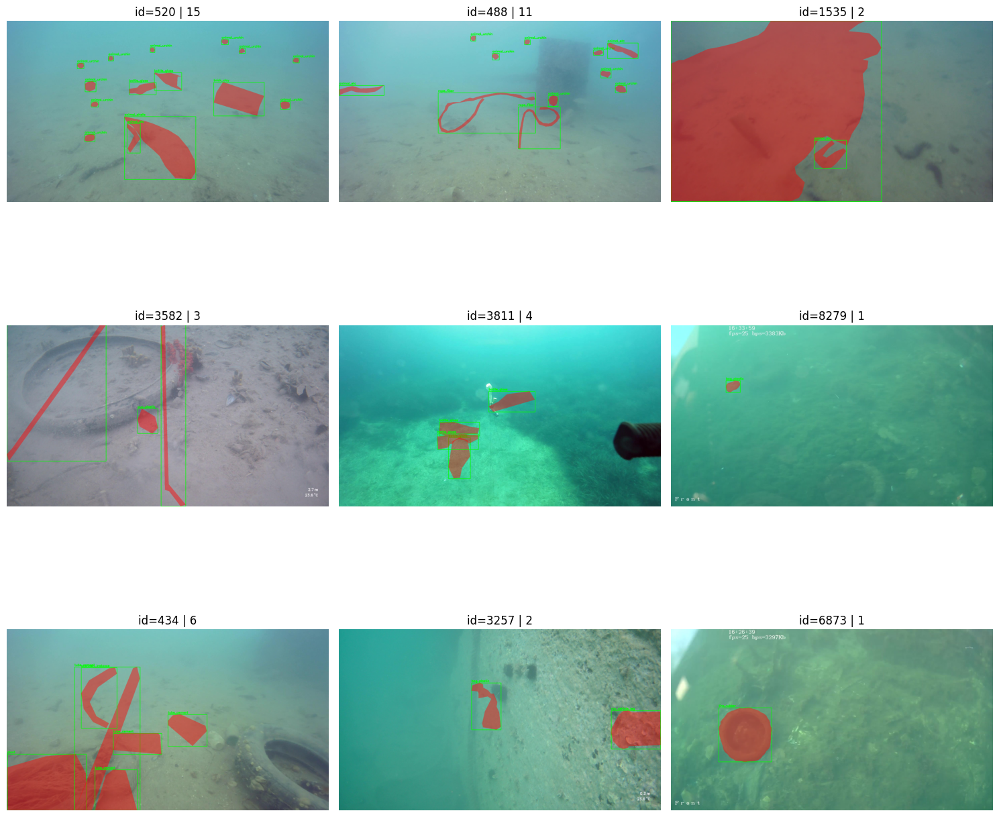

In [40]:
sample_ids = random.sample(img_ids, k=9)
show_grid(sample_ids, cols=3)

## Qualitative check by domain

Location: Bistrina | images: 3663 | showing: 6


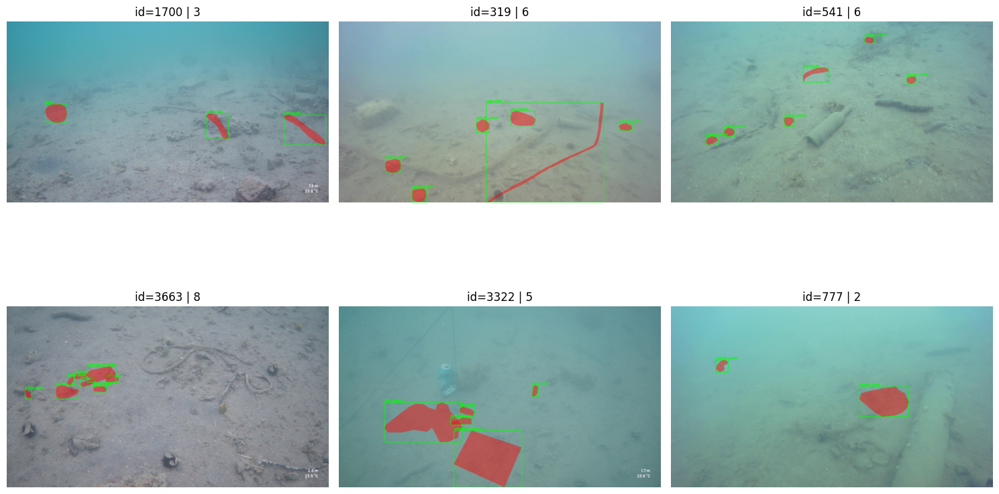

Location: Jakljan | images: 306 | showing: 6


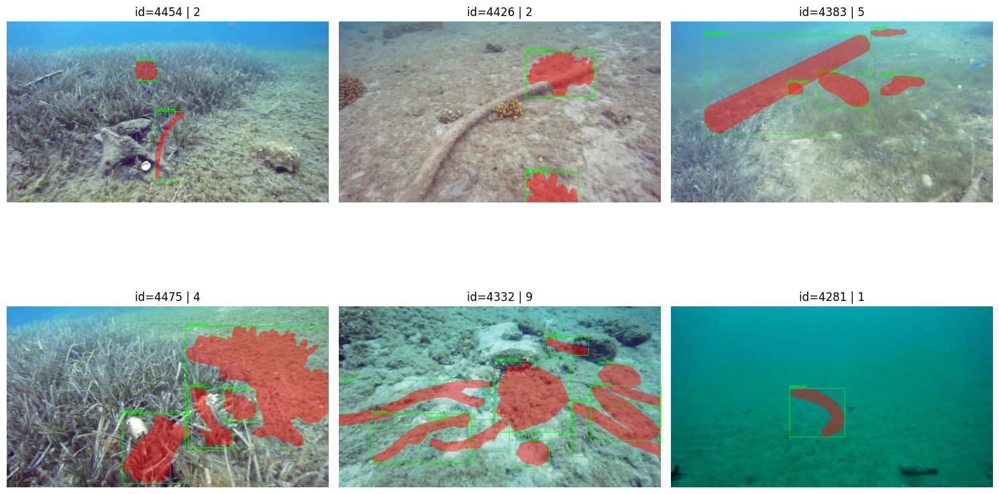

Location: Lokrum | images: 960 | showing: 6


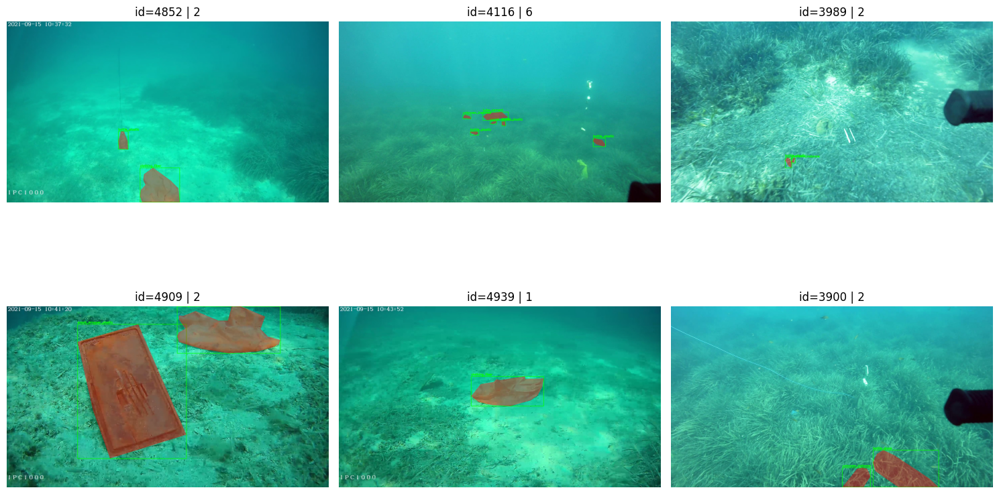

Location: Marseille | images: 3441 | showing: 6


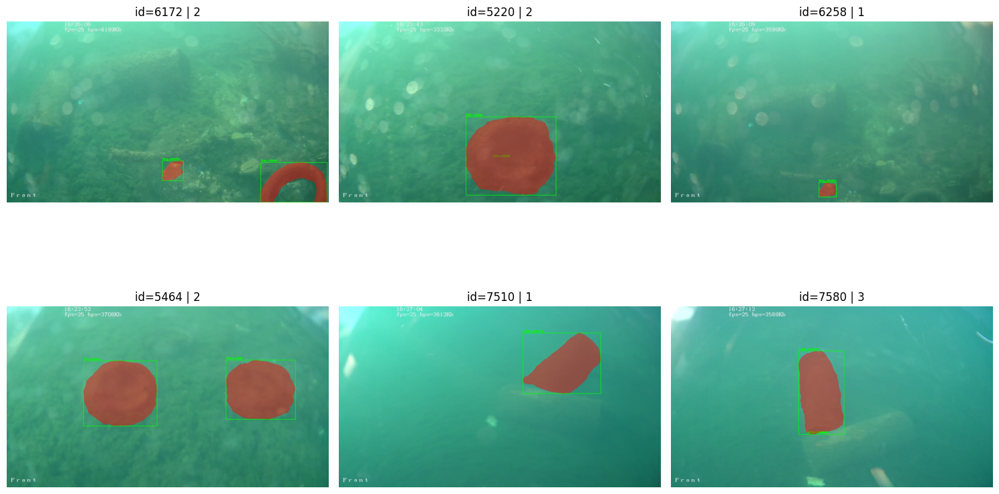

Location: Slano | images: 240 | showing: 6


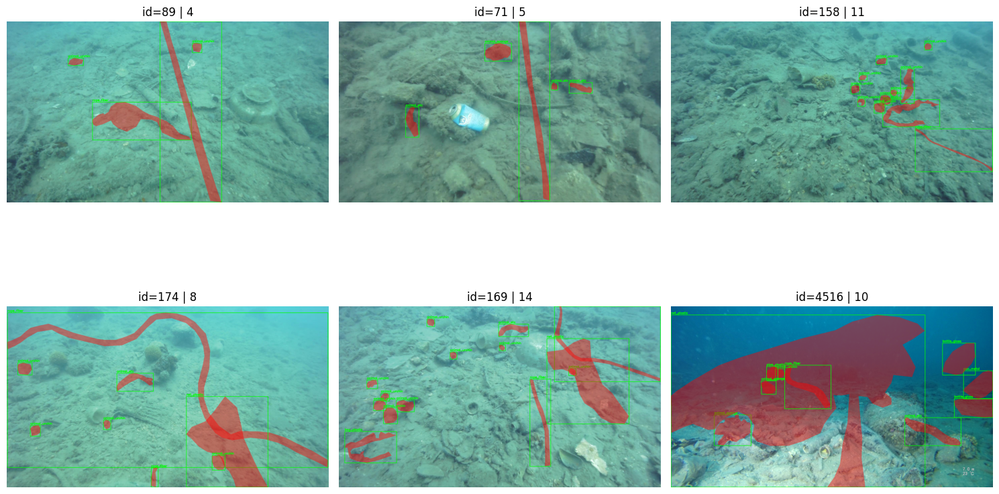

Domain: Marseille/SIP-E323CV | images: 3441 | showing: 6


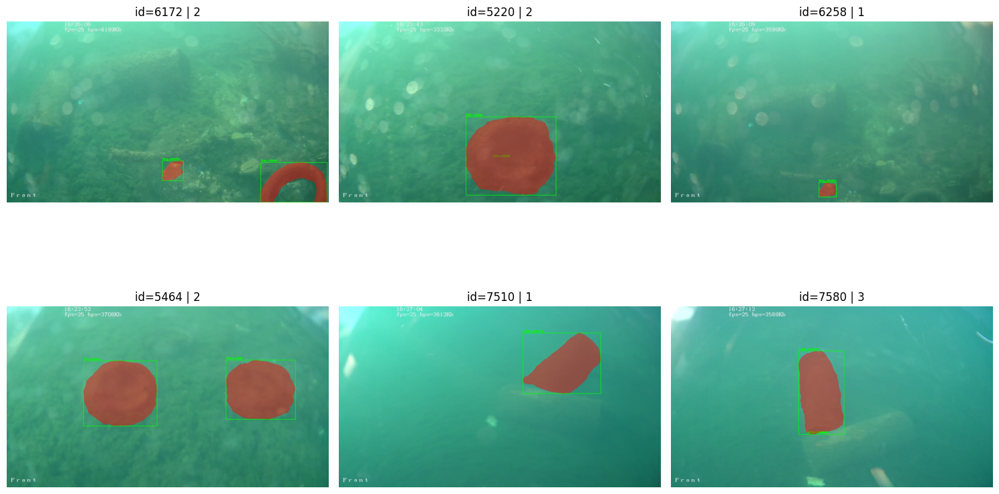

Domain: Bistrina/Paralenz Vaquita Gen 2 | images: 2069 | showing: 6


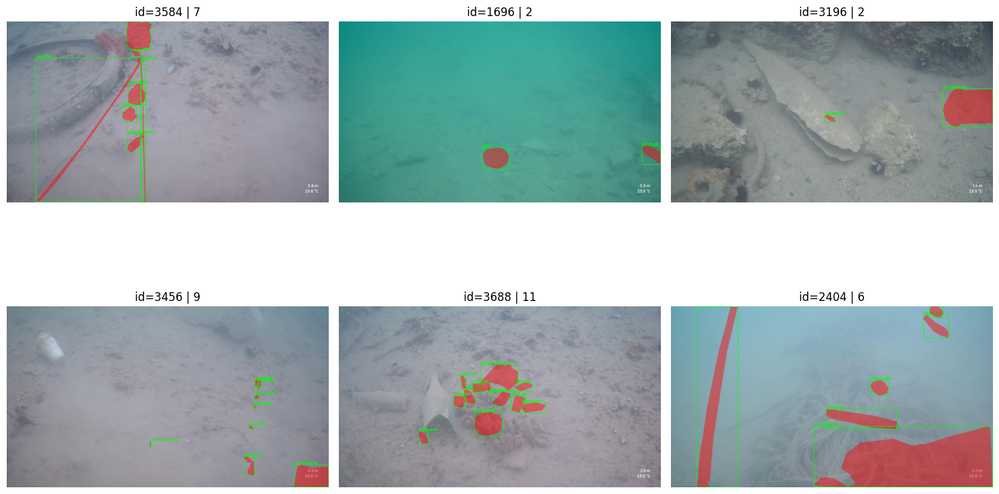

Domain: Bistrina/Bluerobotics HD | images: 1401 | showing: 6


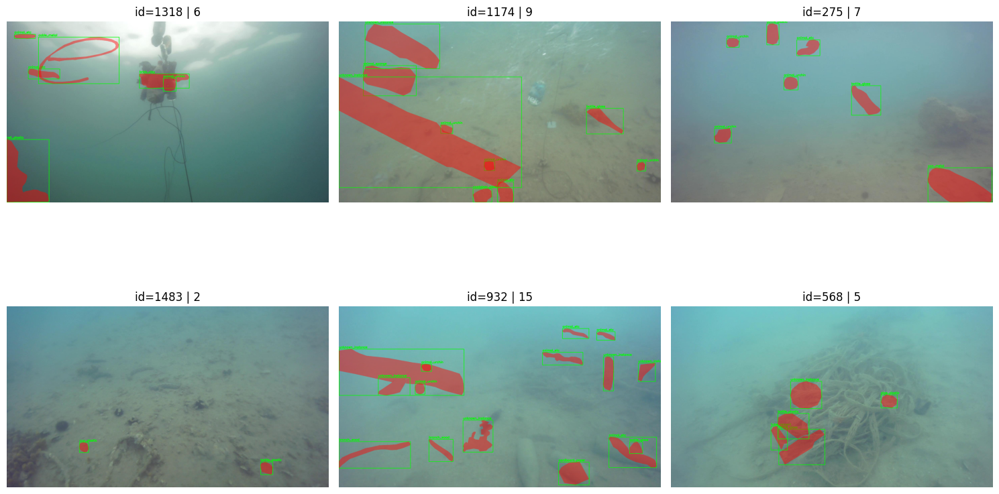

Domain: Lokrum/Bluerobotics HD | images: 556 | showing: 6


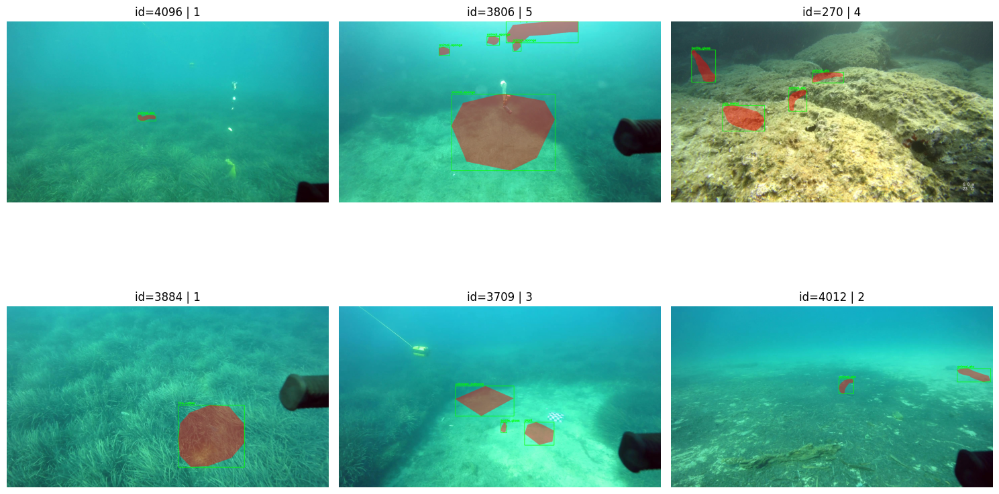

Domain: Lokrum/SIP-E323CV | images: 327 | showing: 6


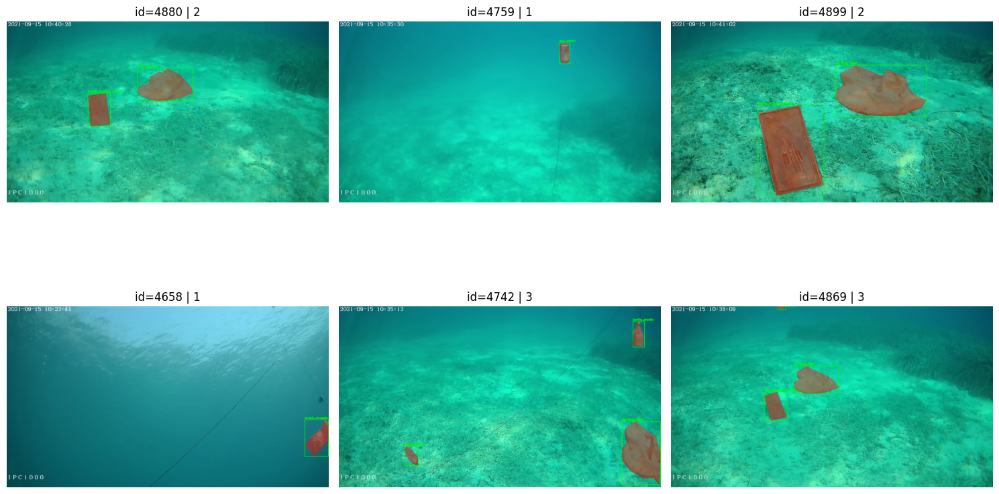

Domain: Jakljan/Bluerobotics HD | images: 241 | showing: 6


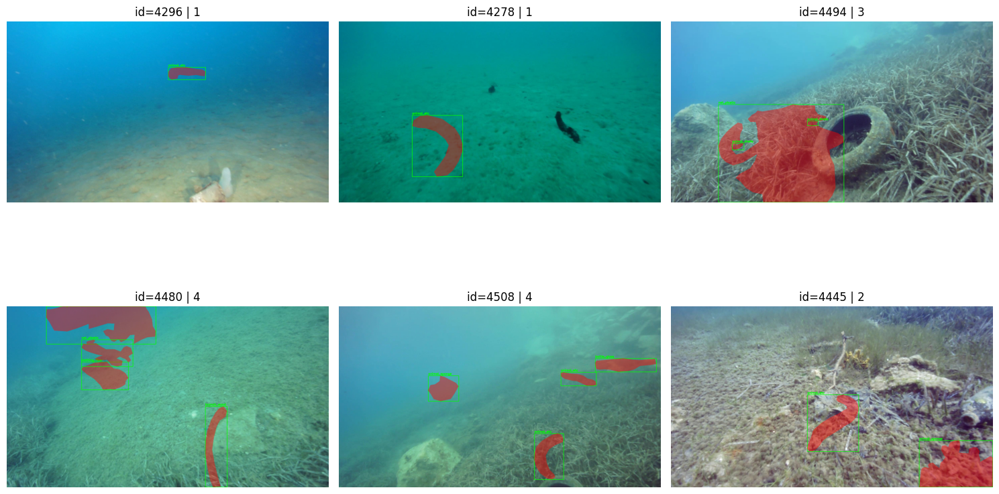

Domain: Bistrina/SIP-E323CV | images: 193 | showing: 6


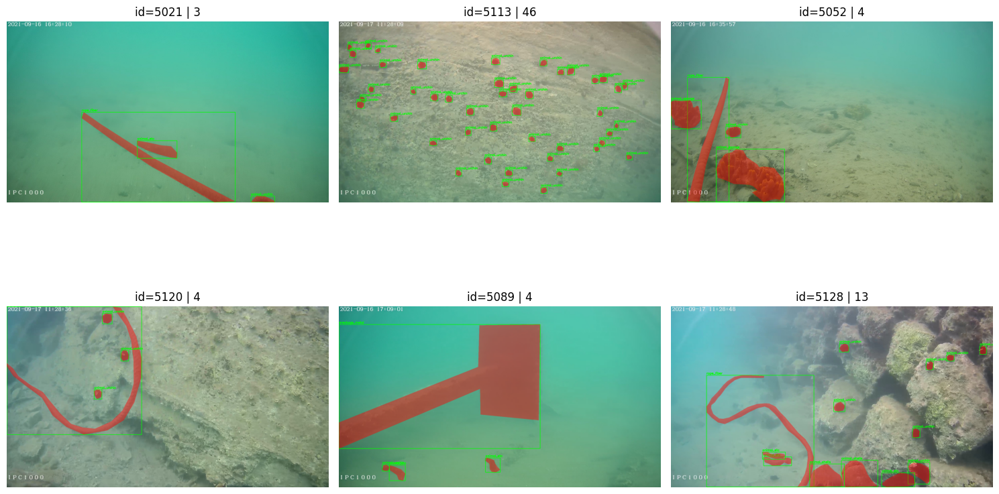

Domain: Slano/Bluerobotics HD | images: 169 | showing: 6


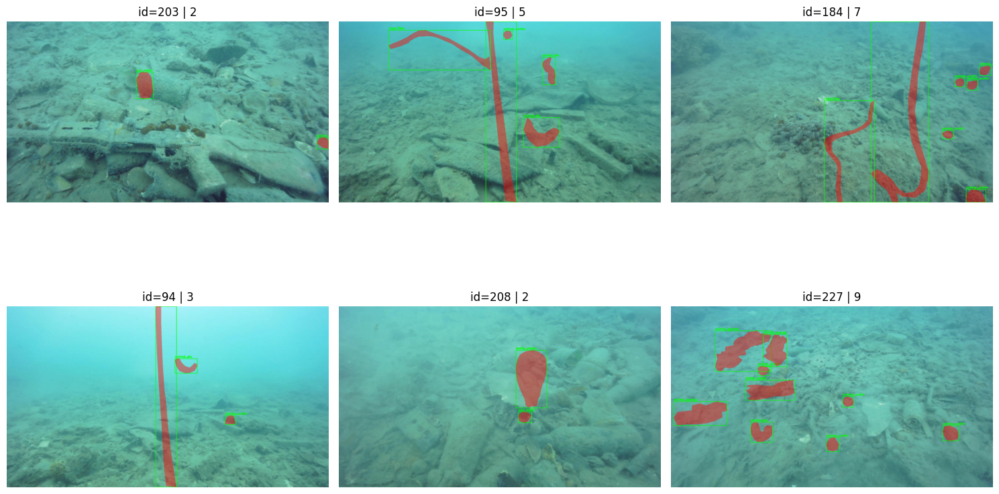

Domain: Lokrum/Paralenz Vaquita Gen 2 | images: 77 | showing: 6


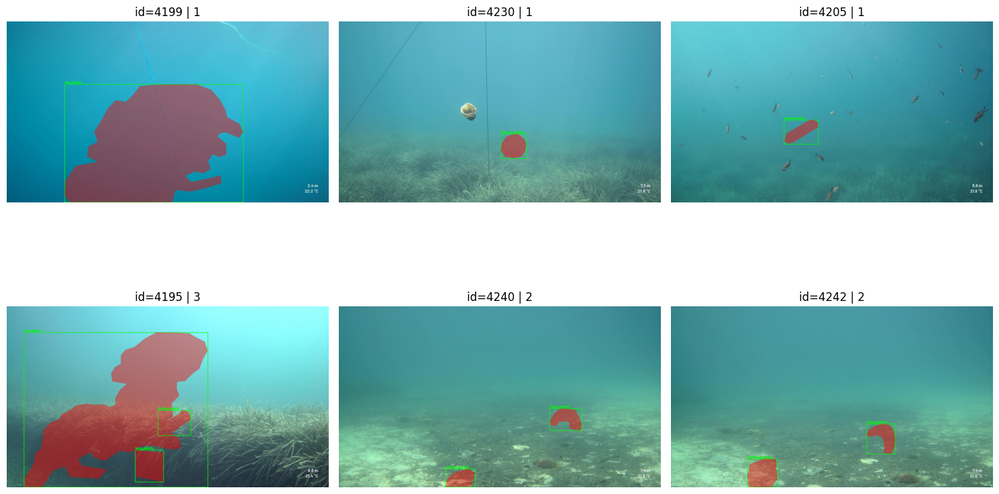

Domain: Slano/Paralenz Vaquita | images: 71 | showing: 6


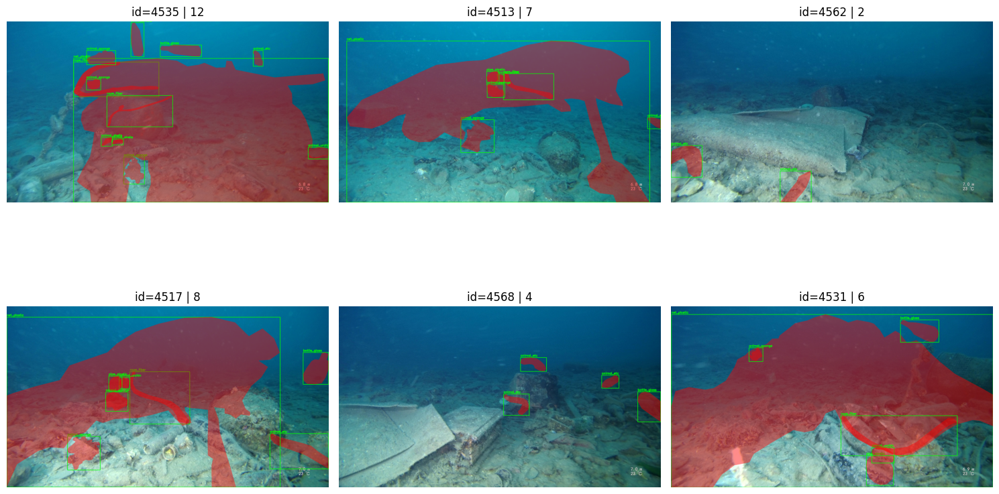

Domain: Jakljan/Paralenz Vaquita | images: 65 | showing: 6


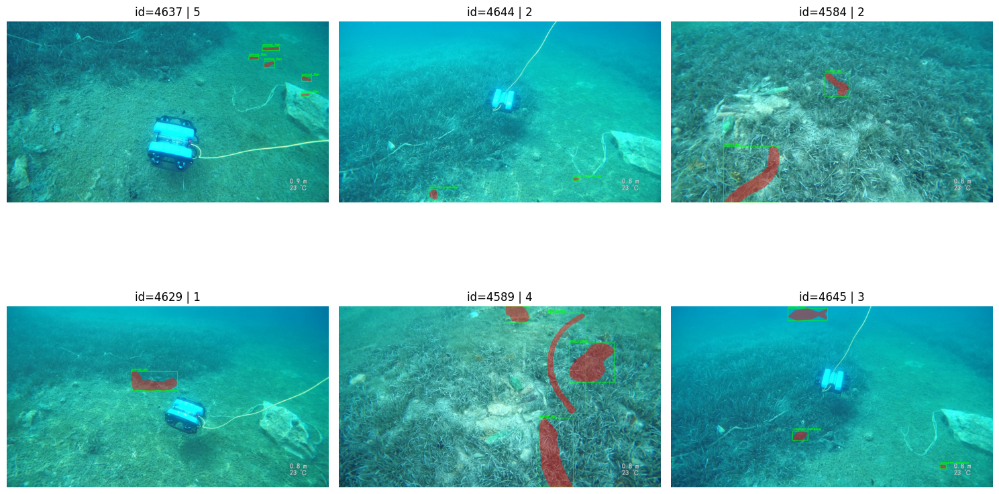

In [41]:
def show_by_location(loc: str, n: int = 6, cols: int = 3):
    sub = img_df[img_df["location"] == loc]
    pick = sub.sample(n=min(n, len(sub)), random_state=SEED)["image_id"].tolist()
    print(f"Location: {loc} | images: {len(sub)} | showing: {len(pick)}")
    show_grid(pick, cols=cols)

def show_by_domain(domain: str, n: int = 6, cols: int = 3):
    sub = img_df[img_df["domain"] == domain]
    pick = sub.sample(n=min(n, len(sub)), random_state=SEED)["image_id"].tolist()
    print(f"Domain: {domain} | images: {len(sub)} | showing: {len(pick)}")
    show_grid(pick, cols=cols)

for loc in sorted(img_df["location"].unique()):
    show_by_location(loc, n=6, cols=3)

for dom in domain_counts.sort_values("n_images", ascending=False)["domain"].tolist():
    show_by_domain(dom, n=6, cols=3)

## Most crowded image example

Most crowded image: 3558 | anns: 74


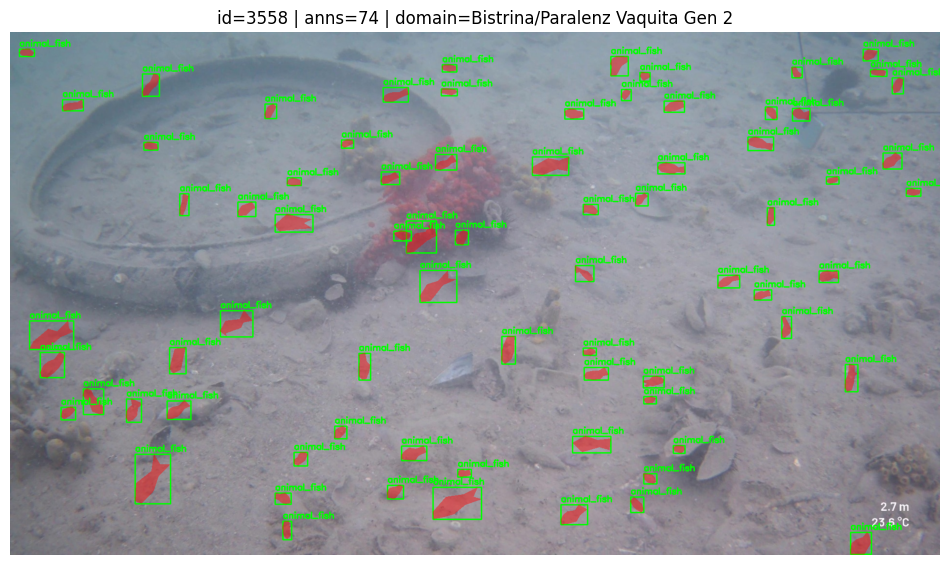

In [42]:
max_img_id = int(ann_per_img.idxmax())
print("Most crowded image:", max_img_id, "| anns:", int(ann_per_img.max()))
show_image(max_img_id)

## Train/val/test splits (COCO JSON export)
Create image-level train/val/test splits and export new COCO JSON files with superclass labels.


In [43]:
OUT_DIR = Path("artifacts/torchvision_maskrcnn")
SPLIT_DIR = OUT_DIR / "splits"

OUT_DIR.mkdir(parents=True, exist_ok=True)
SPLIT_DIR.mkdir(parents=True, exist_ok=True)

In [44]:
SPLIT_DIR.mkdir(parents=True, exist_ok=True)

coco_src = json.loads(COCO_JSON.read_text(encoding="utf-8"))
id2rel = {int(im["id"]): str(Path(im["file_name"])) for im in coco_src["images"]}

super_names = sorted(ann_cut["superclass"].dropna().unique())
super2id = {name: i + 1 for i, name in enumerate(super_names)}
categories_super = [{"id": super2id[n], "name": n} for n in super_names]

keep_ann_ids = set(ann_cut["ann_id"].astype(int))

annid2newcat = dict(zip(
    ann_cut["ann_id"].astype(int),
    ann_cut["superclass"].map(super2id).astype(int)
))

def make_coco_split_super(src_json_path: Path, out_json_path: Path, keep_img_ids: set):
    out_json_path.parent.mkdir(parents=True, exist_ok=True)

    coco_src = json.loads(src_json_path.read_text(encoding="utf-8"))

    images = [im.copy() for im in coco_src["images"] if int(im["id"]) in keep_img_ids]
    for im in images:
        im["file_name"] = id2rel[int(im["id"])]

    ann_out = []
    for a in coco_src["annotations"]:
        aid = int(a.get("id", -1))       # ann_id
        iid = int(a["image_id"])
        if (iid in keep_img_ids) and (aid in keep_ann_ids):
            a2 = a.copy()
            a2["category_id"] = int(annid2newcat[aid])
            ann_out.append(a2)

    coco_out = {"images": images, "annotations": ann_out, "categories": categories_super}
    out_json_path.write_text(json.dumps(coco_out), encoding="utf-8")
    print("Saved:", out_json_path, "| images:", len(images), "| ann:", len(ann_out), "| classes:", len(categories_super))

annotated_ids = ann_cut["image_id"].astype(int).unique().tolist()

train_ids, test_ids = train_test_split(annotated_ids, test_size=0.2, random_state=SEED)
train_ids, val_ids  = train_test_split(train_ids, test_size=0.2/(1-0.15), random_state=SEED)

train_ids, val_ids, test_ids = map(lambda x: set(map(int, x)), [train_ids, val_ids, test_ids])

make_coco_split_super(COCO_JSON, SPLIT_DIR/"train.json", train_ids)
make_coco_split_super(COCO_JSON, SPLIT_DIR/"test.json",  test_ids)
make_coco_split_super(COCO_JSON, SPLIT_DIR/"val.json",   val_ids)

Saved: artifacts\torchvision_maskrcnn\splits\train.json | images: 5126 | ann: 14106 | classes: 10
Saved: artifacts\torchvision_maskrcnn\splits\test.json | images: 1676 | ann: 4557 | classes: 10
Saved: artifacts\torchvision_maskrcnn\splits\val.json | images: 1578 | ann: 4246 | classes: 10
